In [77]:

# Notebook imports
import os
import sys
import json
import numpy as np

In [2]:
from esat.data.datahandler import DataHandler
from esat.model.sa import SA
from esat.model.batch_sa import BatchSA
from esat.data.analysis import ModelAnalysis, BatchAnalysis

In [3]:
cwd = os.getcwd()
print(cwd)

D:\PhD\Research\New Mexico Flaring\STA496-UOGD\Model


In [92]:
# NMF Less Ozone Dataset
norm_less_o3 = os.path.join(cwd, "normalized_matrix_less_o3.csv")
uncertainty_matrix = os.path.join(cwd, "uncertainty_matrix.csv")
output_path = os.path.join(cwd, "output", "NmfEPA")

In [93]:
index_col = "time_utc"                  # the index of the input/uncertainty datasets
factors = 5                        # the number of factors
method = "ls-nmf"                   # "ls-nmf", "ws-nmf"
models = 20                         # the number of models to train
init_method = "col_means"           # default is column means "col_means", "kmeans", "cmeans"
init_norm = False                    # if init_method=kmeans or cmeans, normalize the data prior to clustering.
seed = 42                           # random seed for initialization
max_iterations = 10000              # the maximum number of iterations for fitting a model
converge_delta = 0.01               # convergence criteria for the change in loss, Q
converge_n = 10                     # convergence criteria for the number of steps where the loss changes by less than converge_delta
verbose = True                      # adds more verbosity to the algorithm workflow on execution.

In [94]:
# Loading the dataset
input_file = norm_less_o3
uncertainty_file = uncertainty_matrix
output_path = output_path

data_handler = DataHandler(
    input_path=input_file,
    uncertainty_path=uncertainty_file,
    index_col=index_col
)

18-Apr-25 16:04:49 - Input and output configured successfully


In [95]:
# Show the input data metrics, including signal to noise ratio of the data and uncertainty
data_handler.metrics

,Category,S/N,Min,25th,50th,75th,Max
ch4,strong,0.000022,0.0,0.005837,0.014751,0.037383,1.0
co2,strong,3.019740,0.0,0.138504,0.182528,0.242145,1.0
co,strong,0.000000,0.0,0.025942,0.039057,0.060054,1.0
h2s,strong,0.000655,0.0,0.010400,0.023455,0.045418,1.0
so2,strong,0.000619,0.0,0.007997,0.015994,0.023753,1.0
nox,strong,0.206728,0.0,0.006573,0.020407,0.050263,1.0
ethane,strong,1.056449,0.0,0.008412,0.026908,0.075872,1.0
ethene,strong,1.560956,0.0,0.015879,0.044067,0.089992,1.0
propane,strong,1.776291,0.0,0.009312,0.028668,0.080606,1.0
propene,strong,0.806083,0.0,0.005979,0.018663,0.043033,1.0


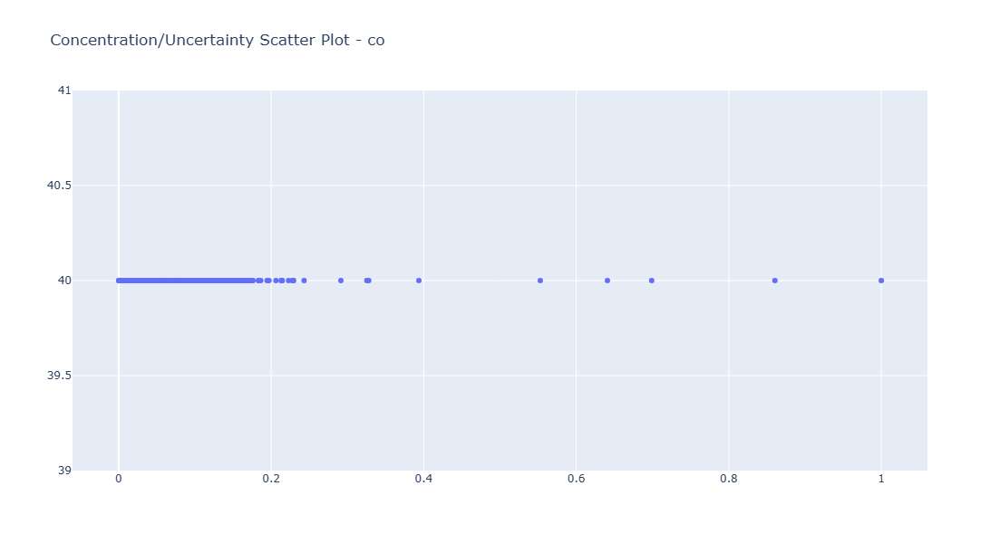

In [90]:
# Concentration / Uncertainty Scatter plot for specific feature, feature/column specified by index
data_handler.plot_data_uncertainty(feature_idx=2)

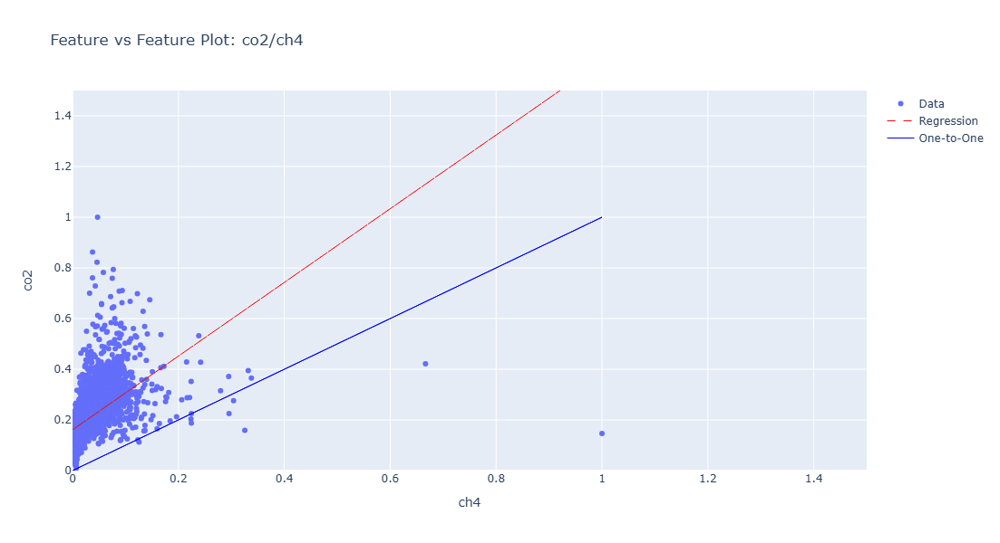

In [91]:
# Species Concentration plot comparing features, features/columns specified by index
data_handler.plot_feature_data(x_idx=0, y_idx=1)

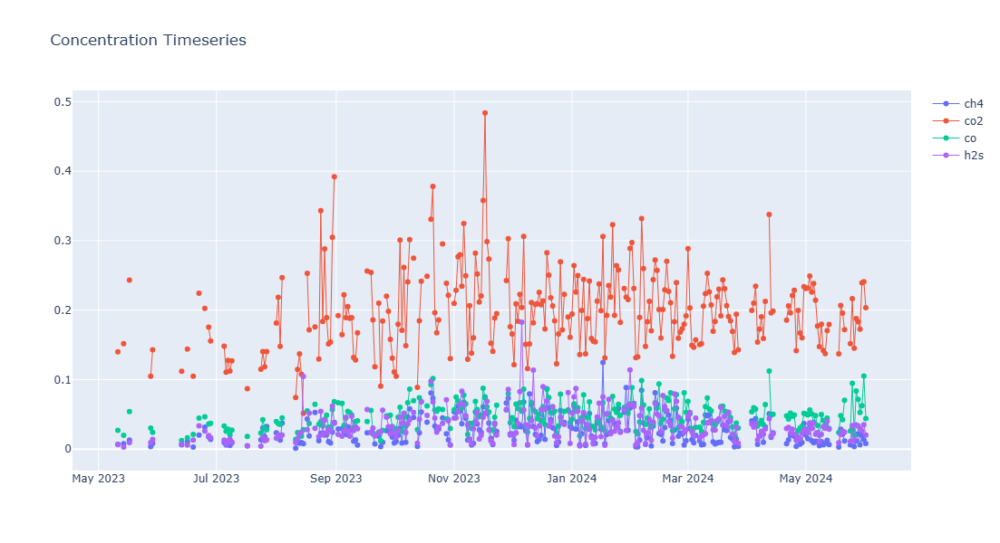

In [96]:
# Species Timeseries, a single or list of features/columns specified by index
data_handler.plot_feature_timeseries(feature_selection=[0, 1, 2, 3])

In [97]:

# Get the processed data and uncertainty
V, U = data_handler.get_data()

In [98]:

%%time
# Training multiple models
sa_models = BatchSA(V=V, U=U, factors=factors, models=models, method=method, seed=seed, max_iter=max_iterations,
                    init_method=init_method, init_norm=init_norm,
                    converge_delta=converge_delta, converge_n=converge_n, optimized=True,
                    verbose=verbose
                   )
_ = sa_models.train()

18-Apr-25 16:08:54 - Running batch SA models in parallel using 15 processes.
18-Apr-25 16:11:20 - Model: 1, Q(true): 29722.7658, MSE(true): 0.2408, Q(robust): 27176.6921, MSE(robust): 0.2202, Seed: 8925, Converged: False, Steps: 9999/10000
18-Apr-25 16:11:20 - Model: 2, Q(true): 29880.4535, MSE(true): 0.2421, Q(robust): 27312.3996, MSE(robust): 0.2213, Seed: 77395, Converged: False, Steps: 9999/10000
18-Apr-25 16:11:20 - Model: 3, Q(true): 29961.9744, MSE(true): 0.2428, Q(robust): 27394.0503, MSE(robust): 0.222, Seed: 65457, Converged: False, Steps: 9999/10000
18-Apr-25 16:11:20 - Model: 4, Q(true): 29718.8657, MSE(true): 0.2408, Q(robust): 27166.6505, MSE(robust): 0.2201, Seed: 43887, Converged: False, Steps: 9999/10000
18-Apr-25 16:11:20 - Model: 5, Q(true): 29912.9446, MSE(true): 0.2424, Q(robust): 27344.2462, MSE(robust): 0.2216, Seed: 43301, Converged: False, Steps: 9999/10000
18-Apr-25 16:11:20 - Model: 6, Q(true): 29717.085, MSE(true): 0.2408, Q(robust): 27173.1942, MSE(robust):

CPU times: total: 375 ms
Wall time: 2min 25s


In [99]:

# Selet the best performing model to review
# best_model = sa_models.best_model
# sa_model = sa_models.results[best_model]
# best_model

10

In [102]:
# Save the batch SA instance
batch_name = "test_batch_10"
batch_output_dir = os.path.join(os.getcwd(), "test_batch")
# os.mkdir(batch_output_dir)
pickle_model = True
pickle_batch = True
header = data_handler.features
sa_models.save(batch_name=batch_name, output_directory=batch_output_dir, pickle_model=pickle_model, pickle_batch=pickle_batch, header=header)

18-Apr-25 16:12:54 - Batch SA models saved to pickle file: D:\PhD\Research\New Mexico Flaring\STA496-UOGD\Model\test_batch\test_batch_10.pkl
18-Apr-25 16:12:54 - All batch SA models saved. Name: test_batch_10, Directory: D:\PhD\Research\New Mexico Flaring\STA496-UOGD\Model\test_batch


'D:\\PhD\\Research\\New Mexico Flaring\\STA496-UOGD\\Model\\test_batch\\test_batch_10.pkl'

In [103]:
# Load the saved batch SA instance
saved_batch_file = os.path.join(os.getcwd(), "test_batch", "test_batch_10.pkl")
batch_sa2 = BatchSA.load(file_path=saved_batch_file)
best_model = batch_sa2.best_model
sa_model = batch_sa2.results[best_model]

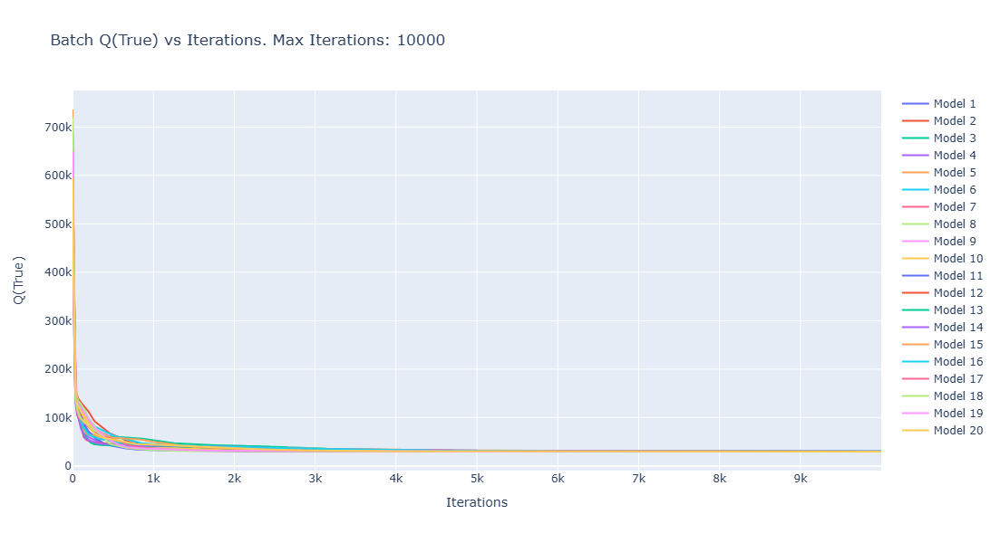

In [104]:
# Perform batch model analysis
batch_analysis = BatchAnalysis(batch_sa=batch_sa2, data_handler=data_handler)
# Plot the loss of the models over iterations
batch_analysis.plot_loss()

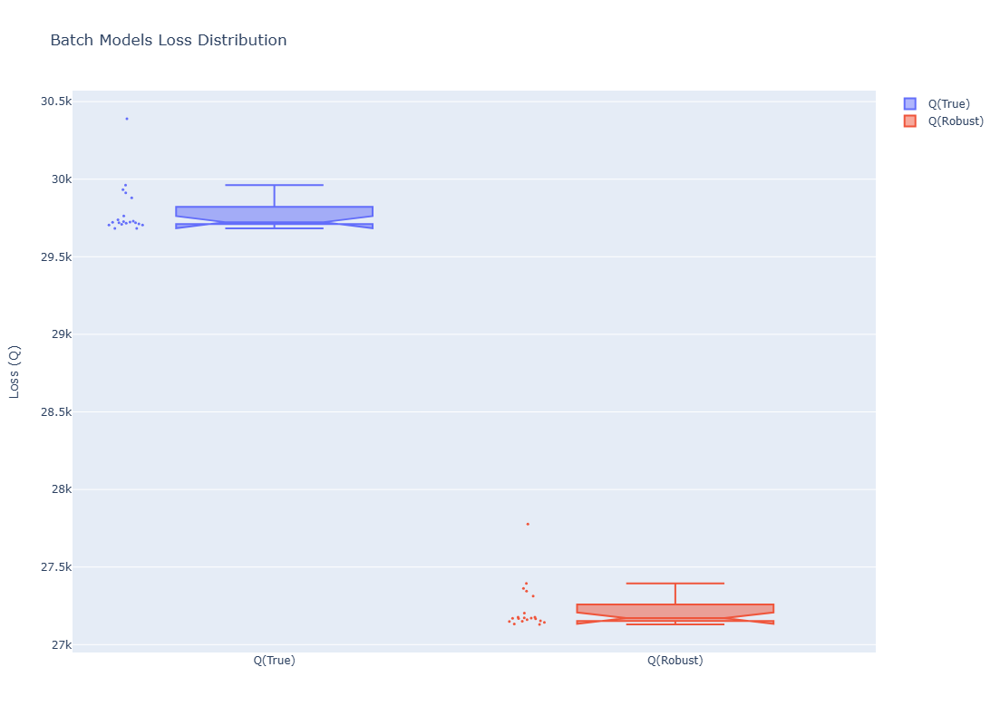

In [105]:
# Plot the loss distribution for the batch models
batch_analysis.plot_loss_distribution()

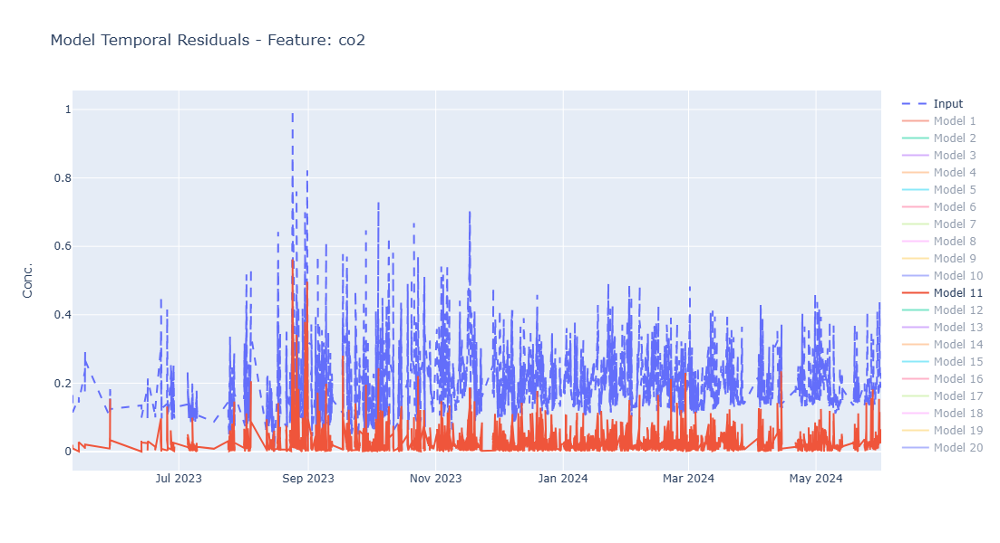

In [106]:

# Plot the temporal residuals for a specified feature, for all models.
batch_analysis.plot_temporal_residuals(feature_idx=1)

In [107]:
# Initialize the Model Analysis module
model_analysis = ModelAnalysis(datahandler=data_handler, model=sa_model, selected_model=best_model)

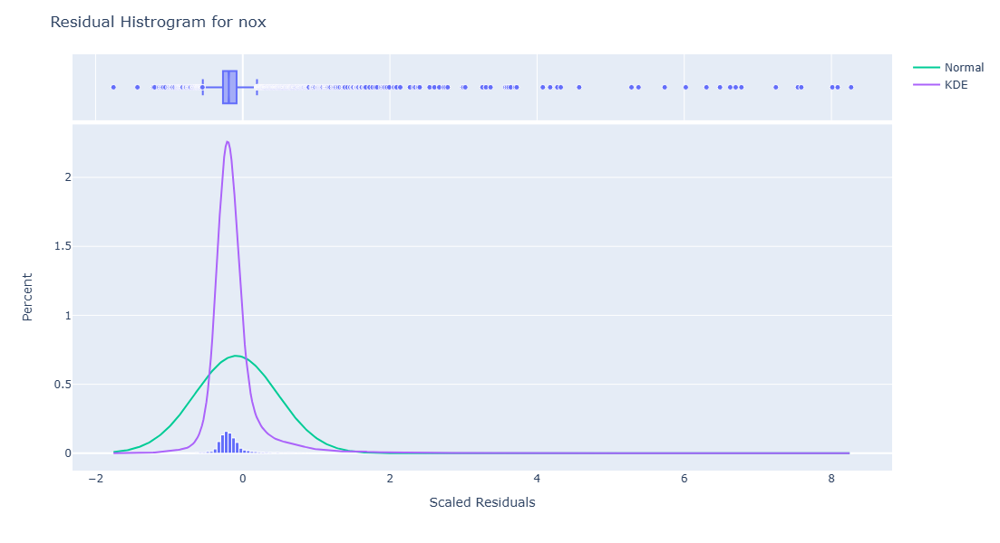

In [108]:
# Residual Analysis shows the scaled residual histogram, along with metrics and distribution curves. The abs_threshold parameter specifies the condition for the returned values of the function call as those residuals which exceed the absolute value of that threshold.
abs_threshold = 3.0
threshold_residuals = model_analysis.plot_residual_histogram(feature_idx=5, abs_threshold=abs_threshold)

In [109]:
print(f"List of Absolute Scaled Residual Greather than: {abs_threshold}. Count: {threshold_residuals.shape[0]}")
threshold_residuals

List of Absolute Scaled Residual Greather than: 3.0. Count: 30


,nox,datetime
15,3.613336,2023-05-29 03:05:00
340,3.367390,2023-08-04 06:05:00
446,5.734141,2023-08-17 06:05:00
453,7.590451,2023-08-17 07:05:00
1209,7.244552,2023-10-15 09:05:00
1303,8.084801,2023-10-26 04:05:00
1310,4.077792,2023-10-26 03:05:00
1482,4.571943,2023-11-07 05:05:00
1483,8.012536,2023-11-07 01:05:00
1489,4.321259,2023-11-08 04:05:00


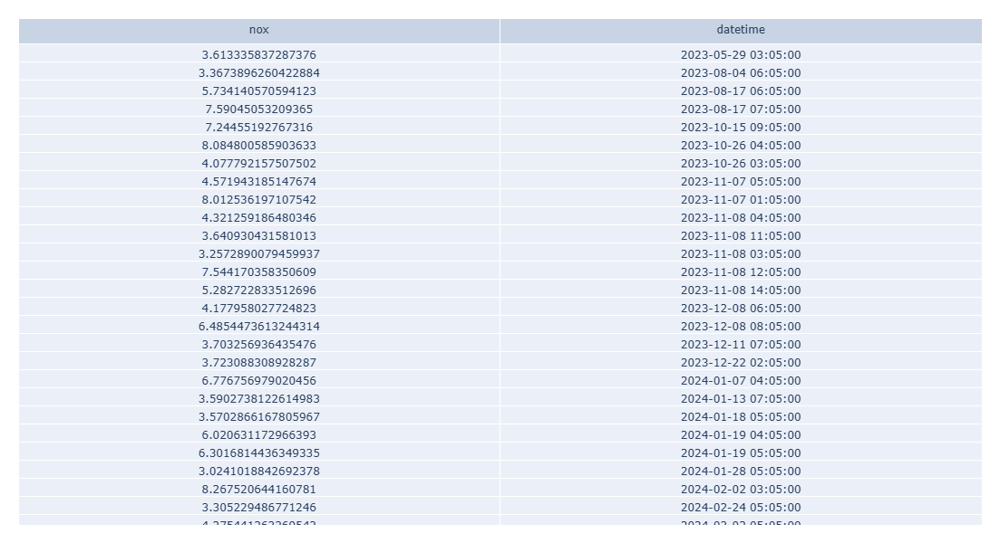

In [110]:
import plotly.graph_objects as go

tr_values = threshold_residuals.to_numpy().T
residuals_table = go.Figure(data=[go.Table(header=dict(values=list(threshold_residuals.columns)), cells=dict(values=tr_values))])
residuals_table.update_layout(width=800, height=600, margin=dict(l=20, r=20, t=20, b=20))
residuals_table.show()

In [111]:
model_analysis.features_metrics()

,Feature,Mean,RMSE,Percentage
0,ch4,0.0270,0.0706,261.48
1,co2,0.2002,0.2111,105.44
2,co,0.0477,0.1405,294.55
3,h2s,0.0352,0.1836,521.59
4,so2,0.0264,0.2060,780.30
5,nox,0.0366,0.2181,595.90
6,ethane,0.0513,0.0773,150.68
7,ethene,0.0622,0.1636,263.02
8,propane,0.0541,0.0502,92.79
9,propene,0.0289,0.1046,361.94


In [112]:
# The model output statistics for the estimated V, including SE: Standard Error metrics, and 3 normal distribution tests of the residuals (KS Normal is used in PMF5)
model_analysis.calculate_statistics()
model_analysis.statistics

,Features,Category,r2,Intercept,Intercept SE,Slope,Slope SE,SE,SE Regression,Anderson Normal Residual,Anderson Statistic,Shapiro Normal Residuals,Shapiro PValue,KS Normal Residuals,KS PValue,KS Statistic
0,ch4,strong,0.852694,0.000878,0.000260,0.962331,0.005807,0.000208,0.014274,No,691.014233,No,4.781892e-85,No,1.736883e-259,0.248865
1,co2,strong,0.804775,0.011885,0.001433,0.907890,0.006492,0.000615,0.041524,No,155.391927,No,1.190395e-51,No,8.190640e-66,0.125676
2,co,strong,0.451757,0.027261,0.000429,0.437550,0.006998,0.000414,0.018577,No,469.069167,No,1.561895e-82,No,1.520134e-182,0.209097
3,h2s,strong,0.245510,0.027307,0.000369,0.261186,0.006647,0.000541,0.019636,No,607.030663,No,1.602755e-84,No,3.164870e-225,0.232042
4,so2,strong,0.046359,0.027221,0.000221,0.066956,0.004409,0.000606,0.012926,No,692.571329,No,5.754194e-85,No,2.209697e-277,0.257190
5,nox,strong,0.384496,0.036687,0.000357,0.298125,0.005476,0.000623,0.020326,No,707.666392,No,6.004902e-82,No,0.000000e+00,0.278899
6,ethane,strong,0.941834,0.004984,0.000272,0.913469,0.003295,0.000228,0.014672,No,367.540786,No,2.065753e-65,No,1.582173e-162,0.197378
7,ethene,strong,0.782575,0.033228,0.000396,0.586298,0.004486,0.000470,0.019380,No,166.616887,No,2.336800e-51,No,2.578762e-82,0.140585
8,propane,strong,0.975742,0.002354,0.000188,0.968678,0.002217,0.000148,0.009978,No,247.050138,No,2.726113e-60,No,1.361650e-117,0.168007
9,propene,strong,0.671476,0.020021,0.000226,0.501081,0.005088,0.000298,0.011792,No,269.236586,No,2.398075e-65,No,3.599068e-126,0.174009


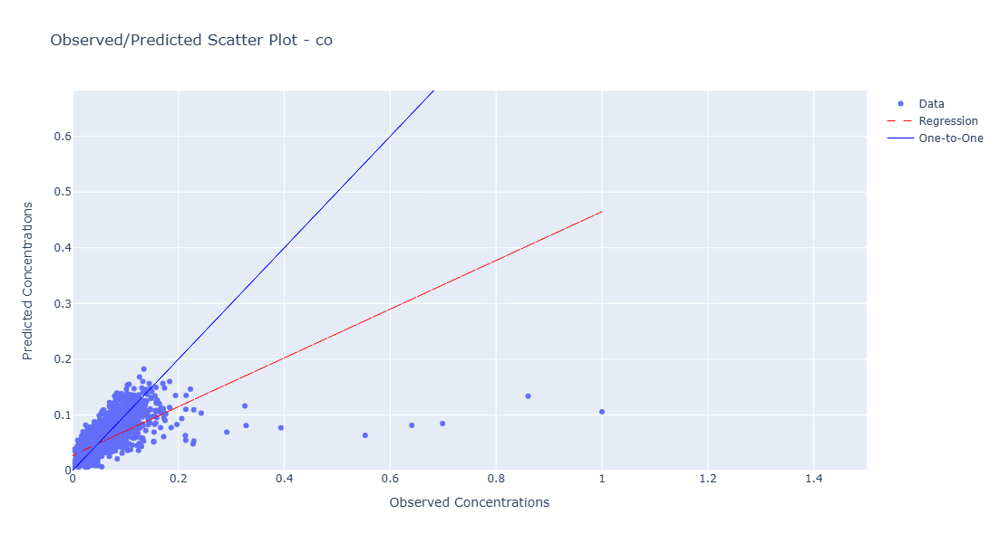

In [113]:
# Model feature observed vs predicted plot with regression and one-to-one lines. Feature/Column specified by index.
model_analysis.plot_estimated_observed(feature_idx=2)

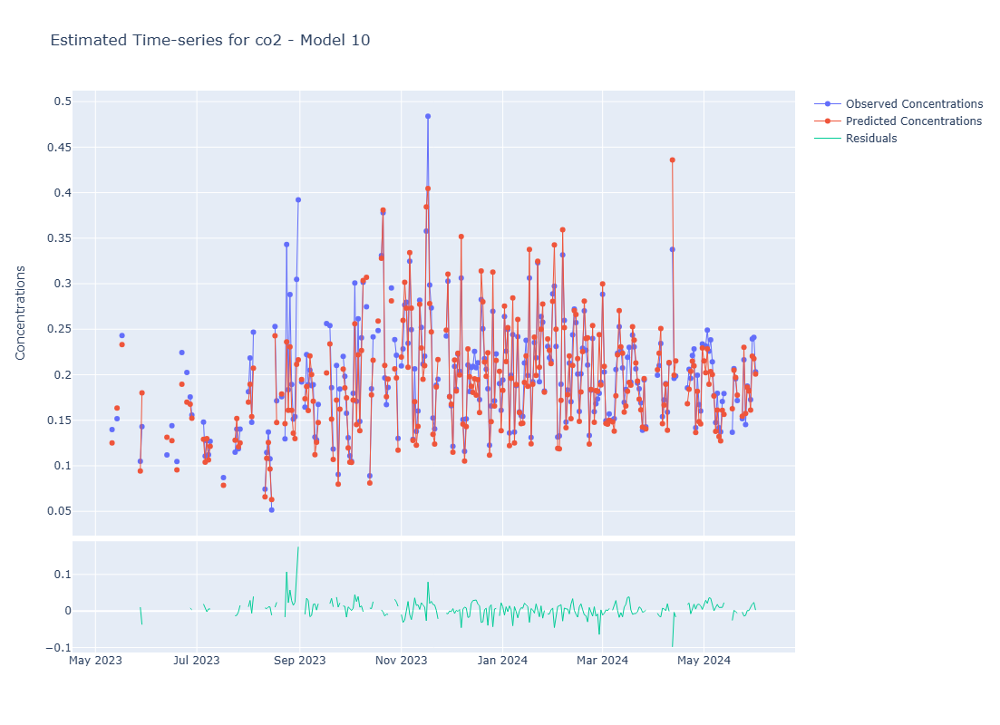

In [114]:
# Model feature timeseries analysis plot showing the observed vs predicted values of the feature, along with the residuals shown below. Feature/column specified by index.
model_analysis.plot_estimated_timeseries(feature_idx=1)

In [117]:
import matplotlib.pyplot as plt
import pandas as pd

# Column names (replace with your actual column names)
column_names = data_handler.metrics.index.values

# Desired order
desired_order = [
    "ethane", "propane", "i-butane", "n-butane", "i-pentane", "n-pentane", 
    "n-hexane", "cyclopentane", "n-heptane", "n-octane",
    "ethene", "propene", "1_3-butadiene", "isoprene",
    "acetylene", "benzene", "toluene", "ethyl-benzene", "o-xylene", 
    "m&p-xylene", "co", "co2", "nox", "h2s", "so2", "o3", "ch4"
]

# Convert numpy array to DataFrame for easy manipulation
df = pd.DataFrame(sa_model.H, columns=column_names)

# Rearrange columns based on the desired order
df = df[[col for col in desired_order if col in df.columns]]

18-Apr-25 16:13:55 - generated new fontManager


In [118]:
df.head

<bound method NDFrame.head of      ethane       propane  i-butane  n-butane     i-pentane     n-pentane  \
0  0.000051  2.225902e-02  0.051009  0.096691  1.161473e-01  9.925438e-02   
1  0.525498  5.391574e-01  0.437606  0.610982  4.207211e-01  3.908609e-01   
2  0.097871  9.501149e-02  0.013157  0.020714  6.155372e-17  3.949930e-25   
3  0.076145  8.920301e-02  0.046311  0.046317  1.392321e-02  1.596688e-16   
4  0.000178  6.748838e-20  0.000737  0.020388  5.963378e-02  8.841270e-02   

       n-hexane  cyclopentane  n-heptane      n-octane  ...   toluene  \
0  6.695266e-02      0.196497   0.040876  8.615213e-16  ...  0.598898   
1  2.822330e-01      0.362396   0.199987  1.092916e-01  ...  0.145486   
2  7.208419e-20      0.009011   0.012499  4.542136e-02  ...  0.017737   
3  5.200332e-18      0.014133   0.011430  8.692070e-02  ...  0.144109   
4  1.648229e-01      0.092835   0.294644  4.933860e-01  ...  0.335658   

   ethyl-benzene      o-xylene  m&p-xylene            co           c

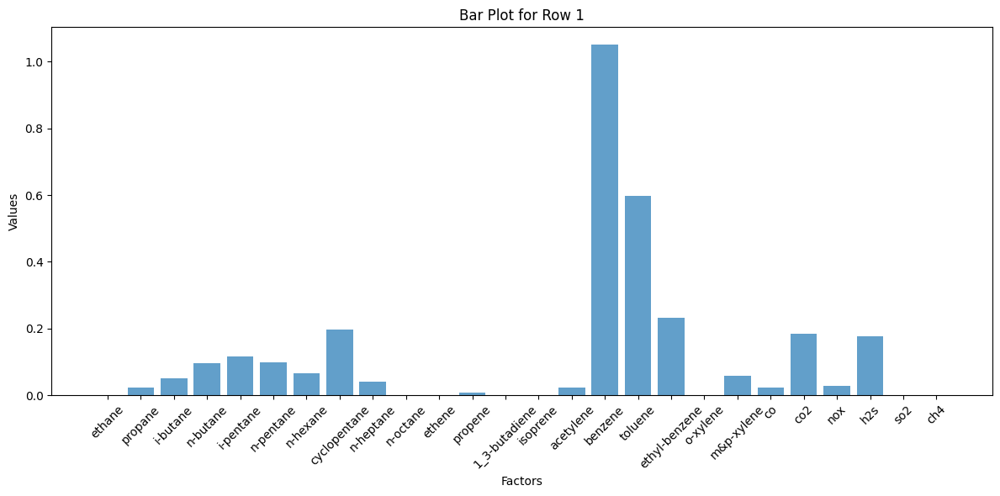

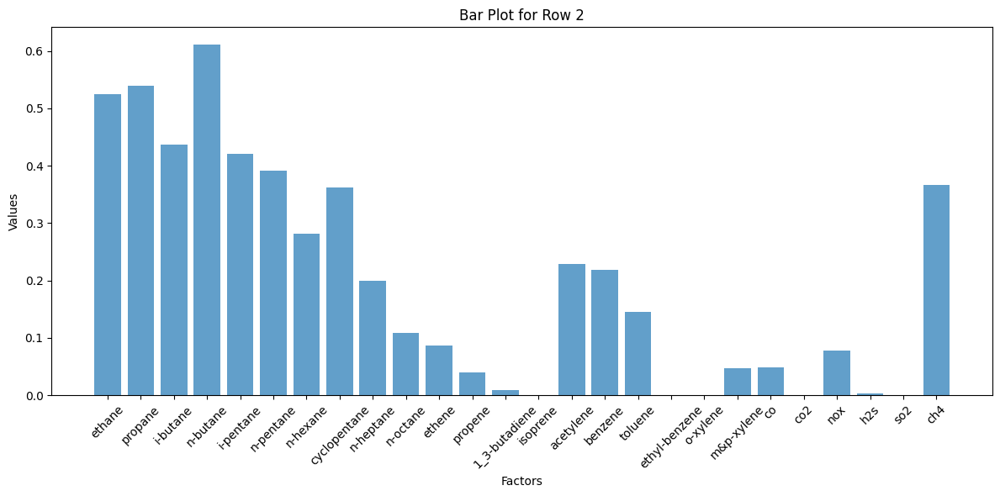

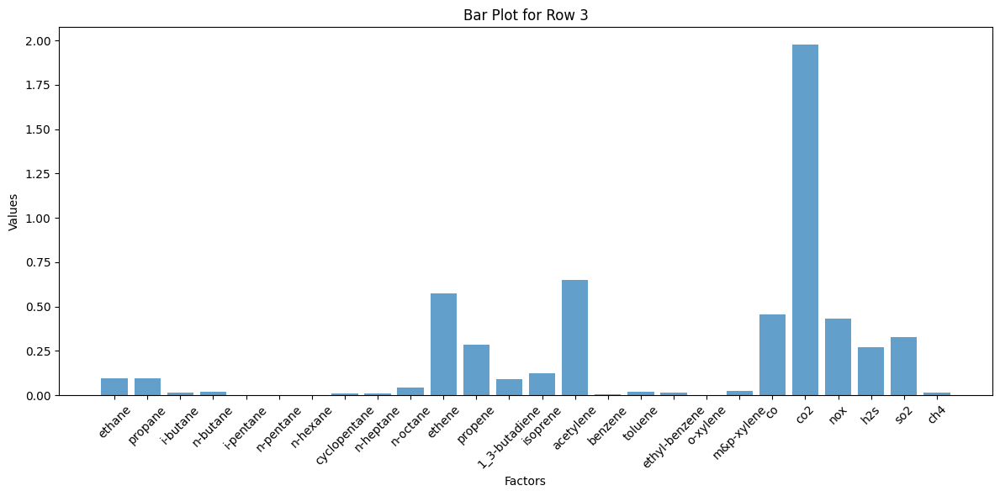

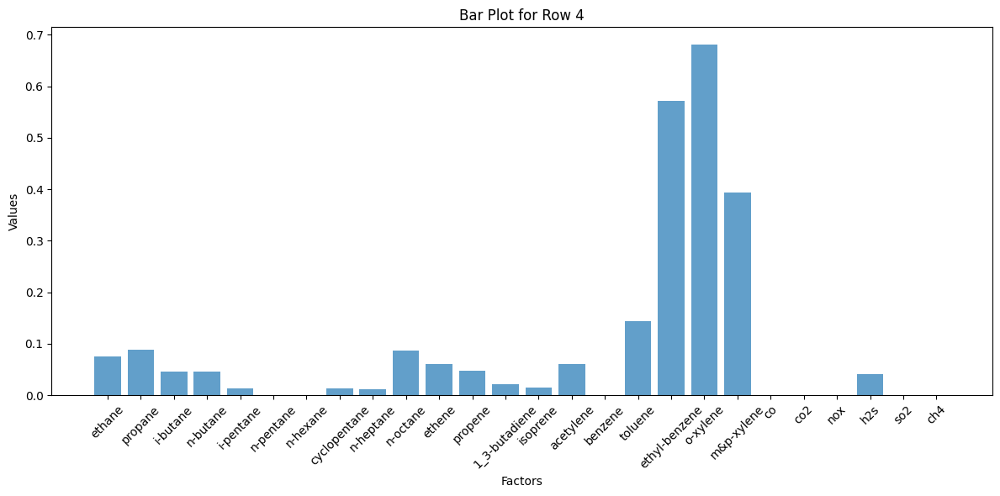

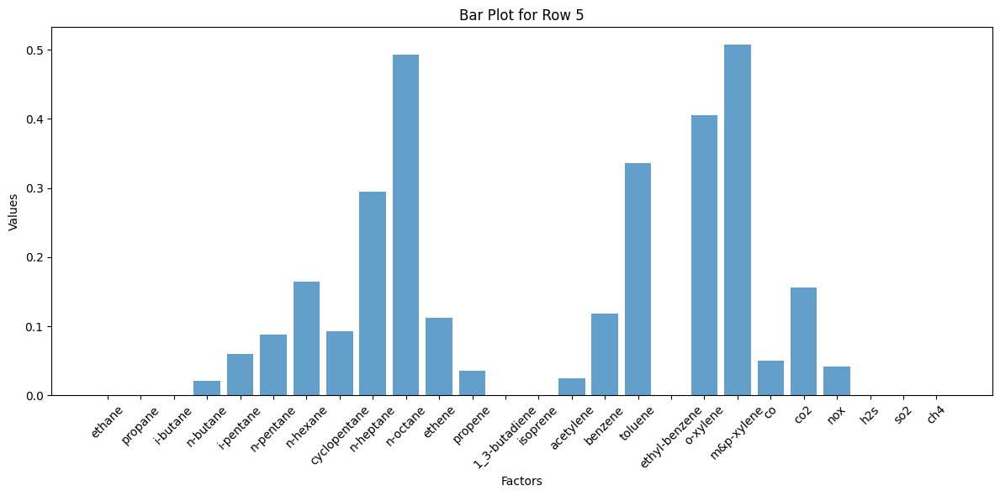

In [119]:
# Create bar plots for each row
for i in range(df.shape[0]):
    plt.figure(figsize=(12, 6))  # Adjust figure size
    plt.bar(df.columns, df.iloc[i], alpha=0.7)  # Use DataFrame columns and row values
    plt.title(f"Bar Plot for Row {i+1}")
    plt.xlabel("Factors")
    plt.ylabel("Values")
    plt.xticks(rotation=45)  # Rotate factor labels for better readability
    plt.tight_layout()
    plt.show()


In [154]:
# Get W and H matrices, X=WH
X = sa_model.V
W = sa_model.W
H = sa_model.H
print(W.shape)
print(H.shape)

(4747, 5)
(5, 26)


In [121]:
sa_model.summary()

18-Apr-25 16:14:10 - ------------		ES Model Details		-----------
18-Apr-25 16:14:10 - 	Method: ls-nmf				Factors: 5
18-Apr-25 16:14:10 - 	Number of Features: 26		Number of Samples: 4747
18-Apr-25 16:14:10 - 	Random Seed: 52647				Optimized: True
18-Apr-25 16:14:10 - ---------------		Model Results		--------------
18-Apr-25 16:14:10 - 	Q(true): 29682.44			Q(robust): 27130.24
18-Apr-25 16:14:10 - 	Converged: True				Converge Steps: 7959
18-Apr-25 16:14:10 - 	Robust Mode: No
18-Apr-25 16:14:10 - ------------------------------------------------------


In [153]:
# Compute Qtrue manually and see if match expression in code
EPSILON = 1e-12
U = data_handler.uncertainty_data_processed
U[U < EPSILON] = EPSILON
_wh = np.matmul(W, H)
residuals = np.subtract(X, _wh)
residuals_u = np.divide(residuals, U)
r2 = np.multiply(residuals_u, residuals_u)
_q = np.sum(r2)
_q

29682.44275235905

In [156]:
# Compute WRSS from each factor
wrss_list = np.zeros(5)
for i in range(1, 6):
    W_temp = W[:,:i]
    H_temp = H[:i, :]

    reconstruction_temp = np.matmul(W_temp, H_temp)
    residuals = np.subtract(X, reconstruction_temp)
    residuals_u = np.divide(residuals, U)
    r2 = np.multiply(residuals_u, residuals_u)
    _q = np.sum(r2)

    wrss_list[i-1] = _q
wrss_list

array([1290834.08540338,  759780.67571426,  593369.02195129,
        209572.74516924,   29682.44275236])

In [171]:
# Compute WRSS from each factor alone
wrss_each_list = np.zeros(5)
for i in range(1, 6):
    W_temp = W[:,i-1:i]
    H_temp = H[i-1:i, :]
    reconstruction_temp = np.matmul(W_temp, H_temp)
    residuals = np.subtract(X, reconstruction_temp)
    residuals_u = np.divide(residuals, U)
    r2 = np.multiply(residuals_u, residuals_u)
    _q = np.sum(r2)
    wrss_each_list[i-1] = _q
wrss_each_list

array([1290834.08540338, 1031277.10040999, 1461795.31715984,
       1145732.29851052, 1072773.3881691 ])

In [161]:
# Get wtss and then variance explained
mean = np.mean(X)
diff = np.subtract(X, mean)
residuals_u = np.divide(diff, U)
r2 = np.multiply(residuals_u, residuals_u)
wtss = np.sum(r2)
variance_explained = 1 - np.divide(wrss_list, wtss)
variance_explained

array([-0.32432064,  0.22050925,  0.39123792,  0.78499056,  0.96954754])

In [149]:
np.zeros(5)

array([0., 0., 0., 0., 0.])

In [68]:
dir(sa_model)

['H',
 'Qrobust',
 'Qtrue',
 'U',
 'V',
 'W',
 'WH',
 'We',
 '_SA__has_neg',
 '_SA__initialized',
 '_SA__validate',
 '_SA__validated',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 'converge_steps',
 'converged',
 'factor_Q',
 'factors',
 'init_method',
 'initialize',
 'load',
 'm',
 'metadata',
 'method',
 'model_i',
 'n',
 'optimized',
 'optimized_update',
 'parallelized',
 'q_list',
 'rng',
 'save',
 'seed',
 'summary',
 'train',
 'update_step',
 'verbose']

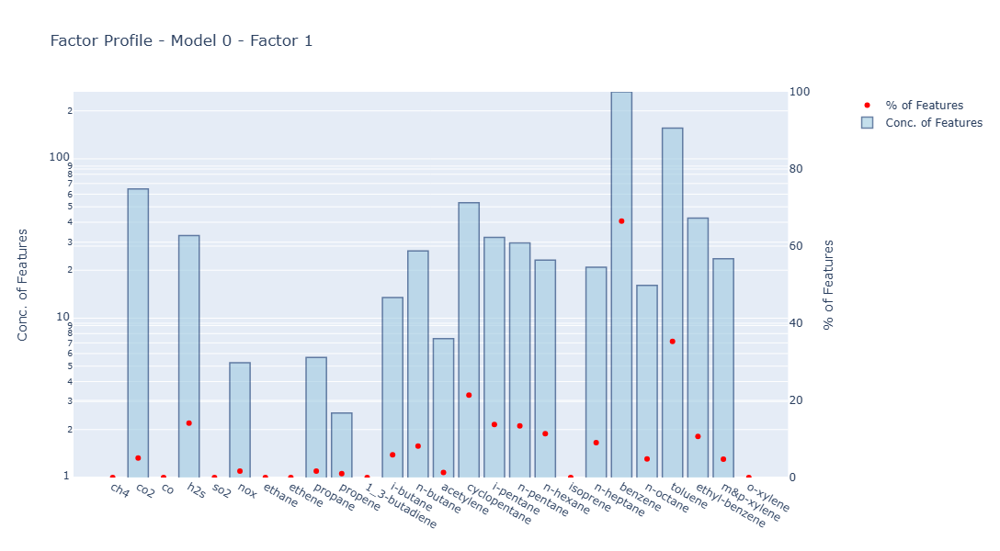

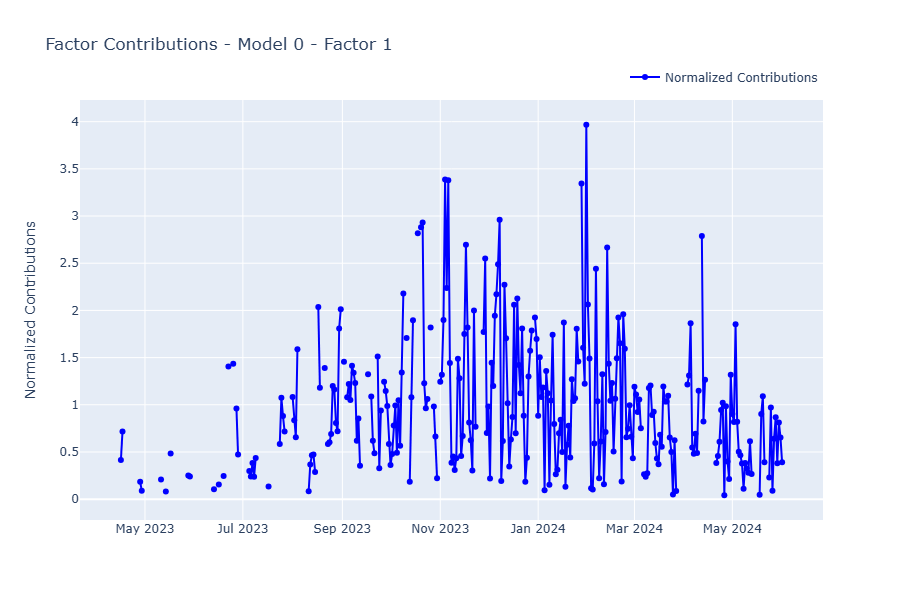

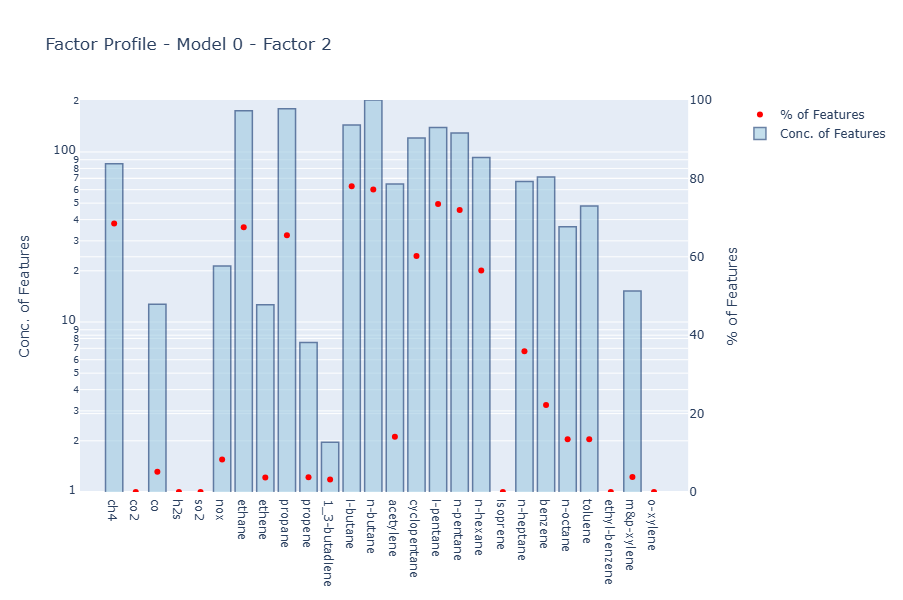

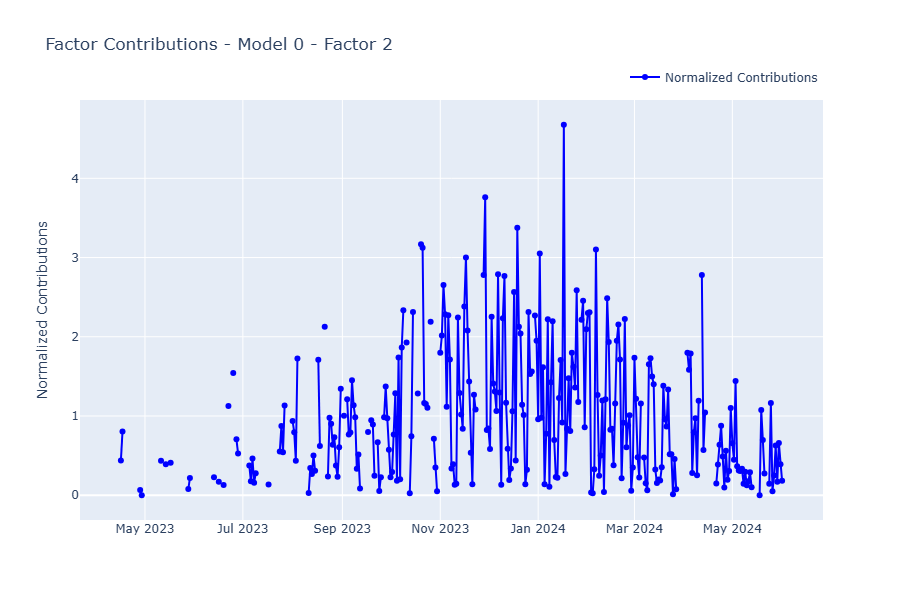

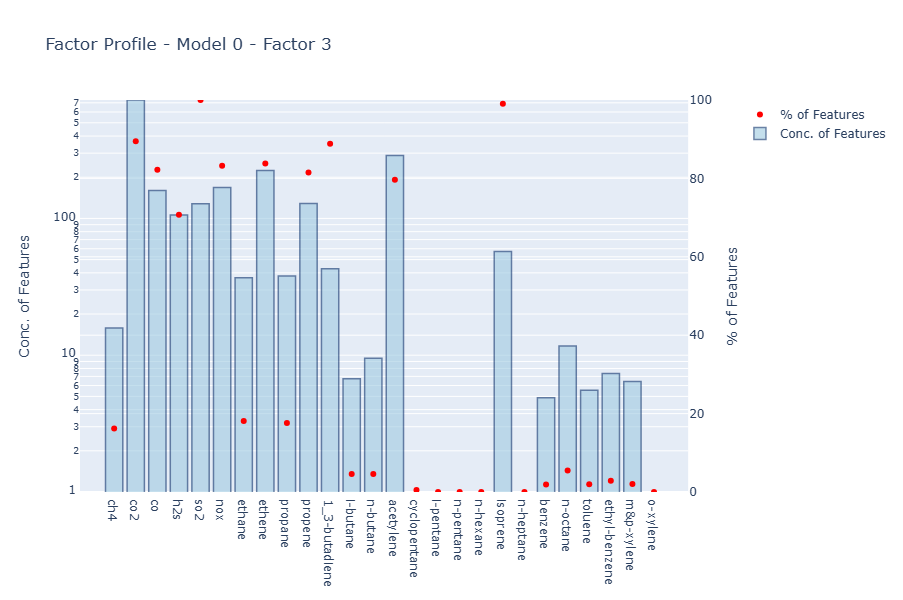

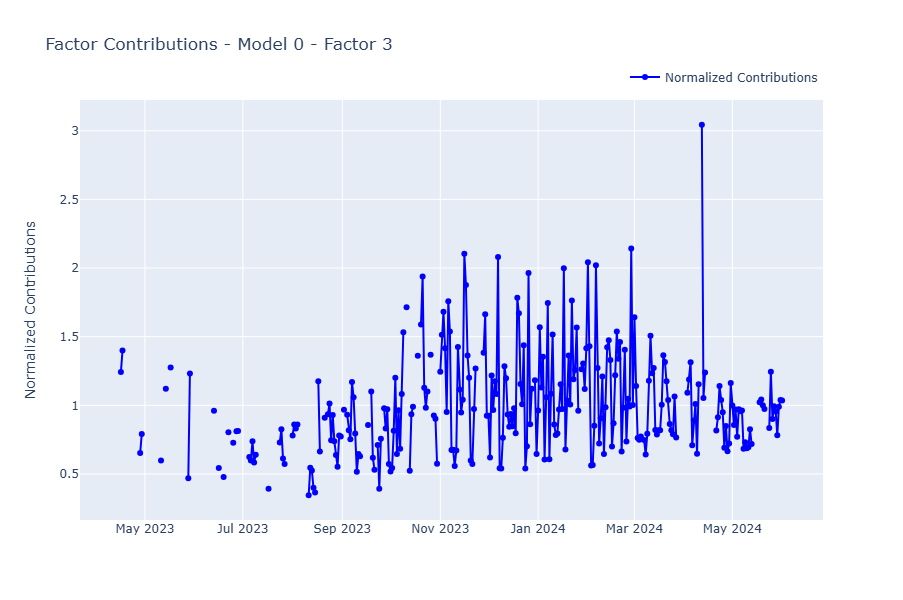

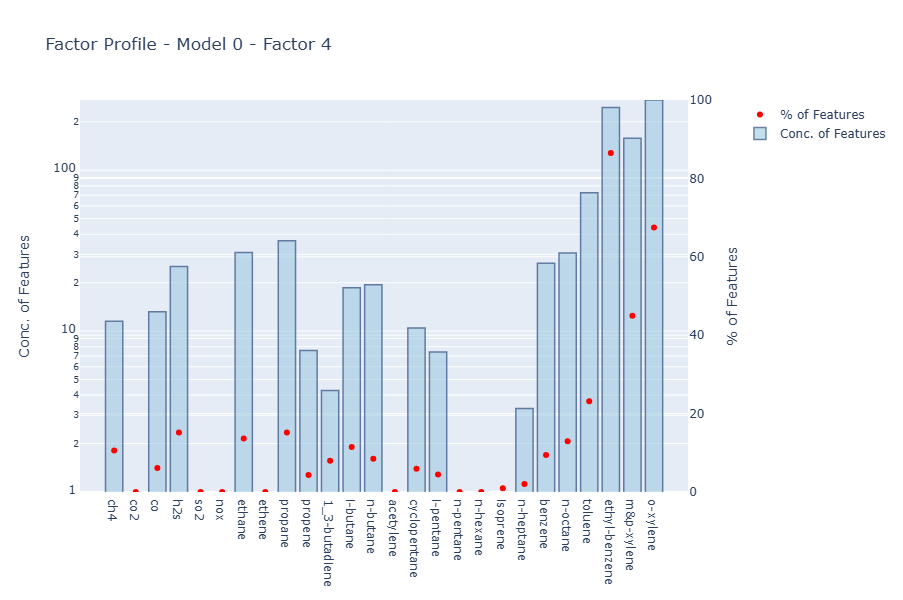

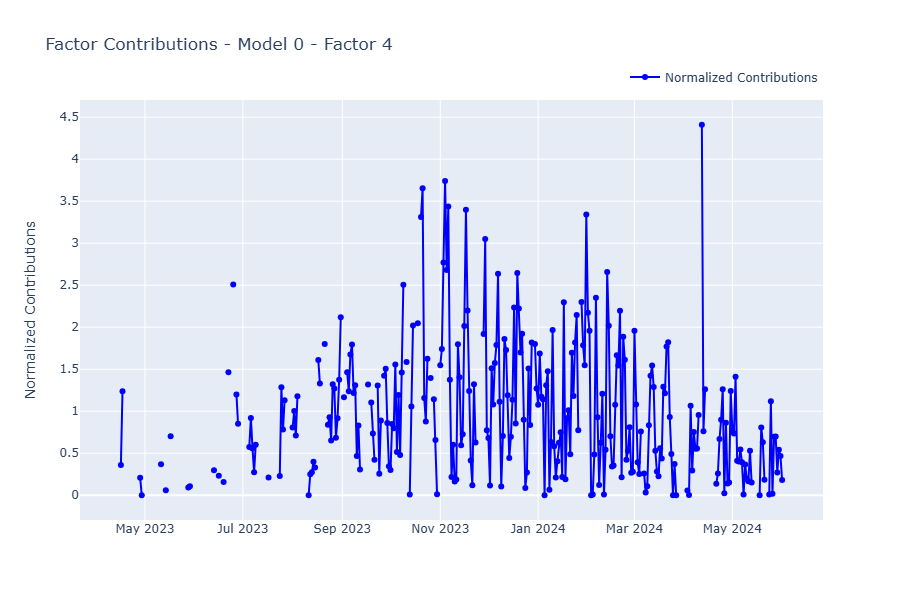

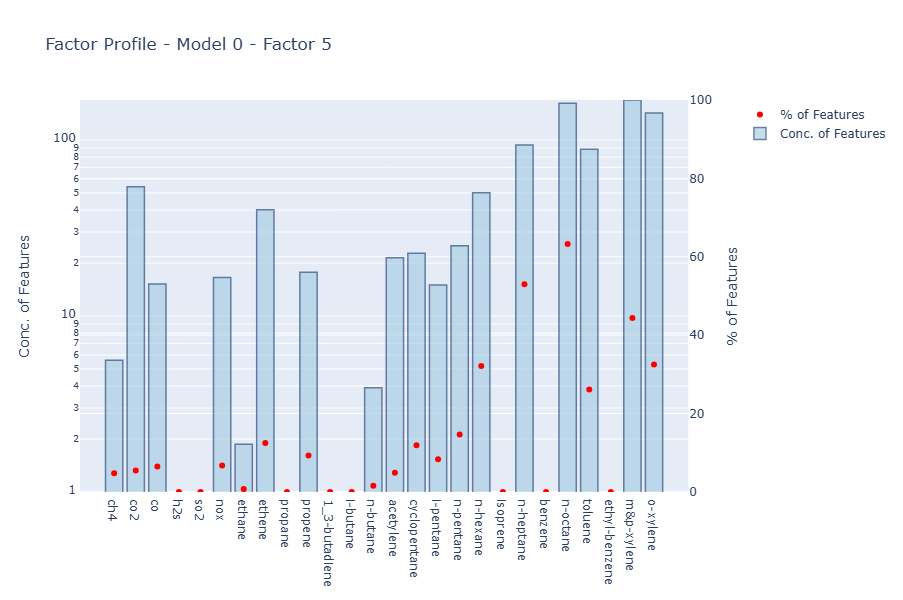

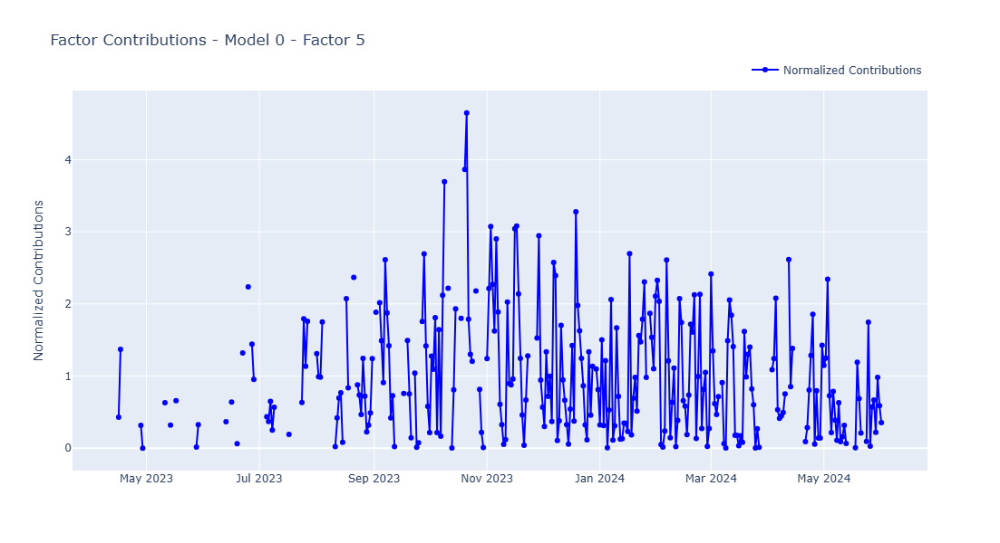

In [38]:
# Factor profile plot showing the factor sum of concentrations by feature (blue bars), the percentage of the feature as the red dot, and in the bottom plot the normalized contributions by date (values are resampled at a daily timestep for timeseries consistency).
# Factor specified by index.
for i in range(1, 6):
    model_analysis.plot_factor_profile(factor_idx=i)

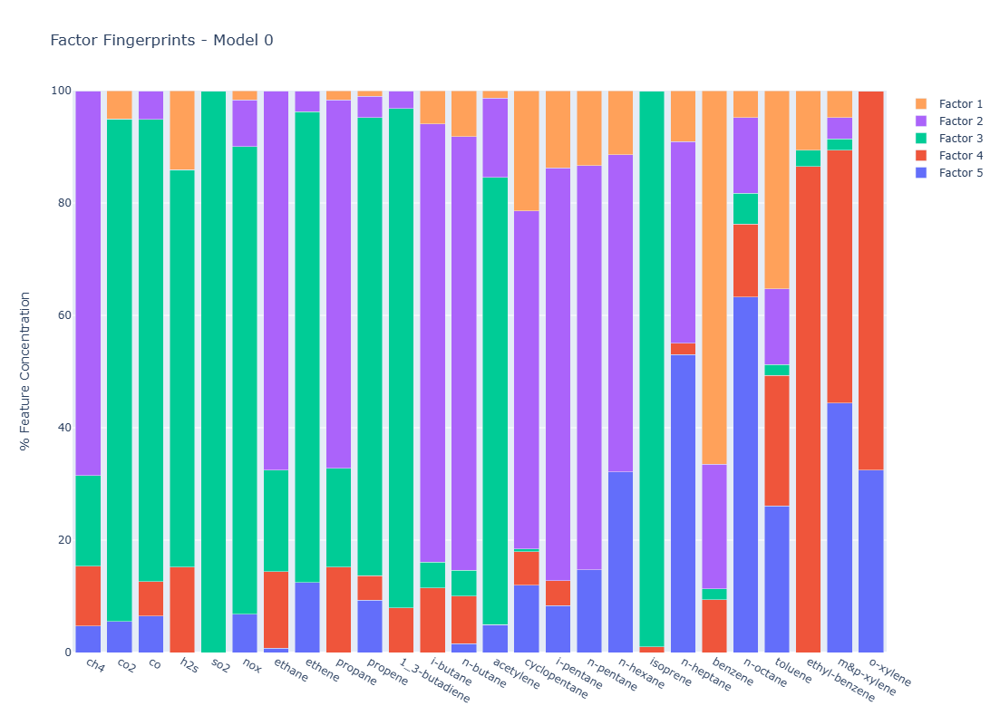

In [28]:
# Model factor fingerprint specifies the feature percentage of each factor.
model_analysis.plot_factor_fingerprints()

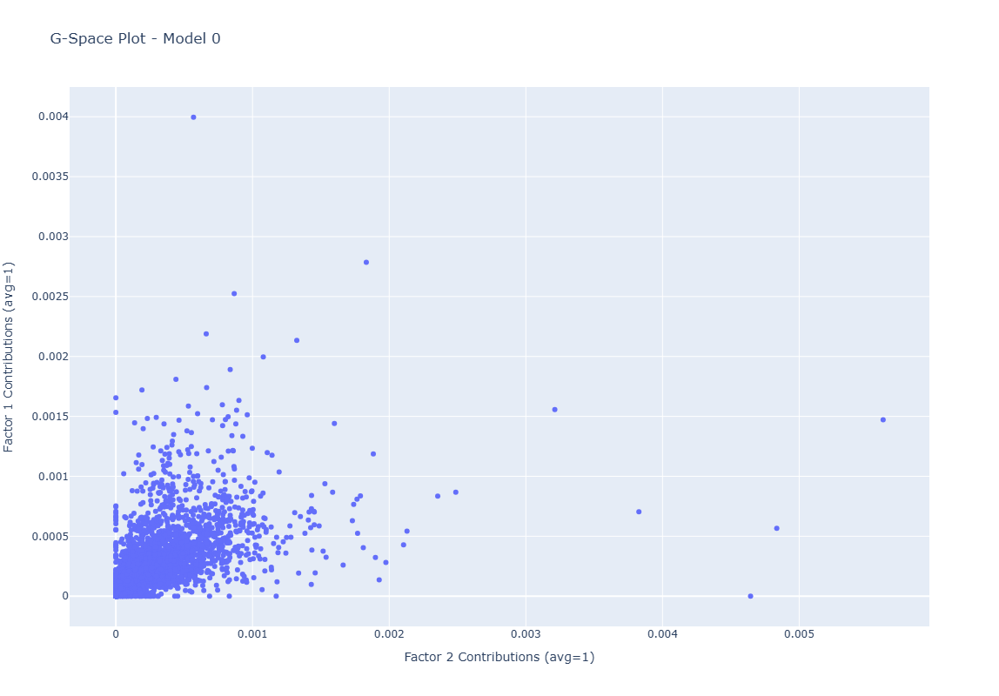

In [29]:

# Factor G-Space plot shows the normalized contributions of one factor vs another factor. Factor specified by index.
model_analysis.plot_g_space(factor_1=2, factor_2=1)

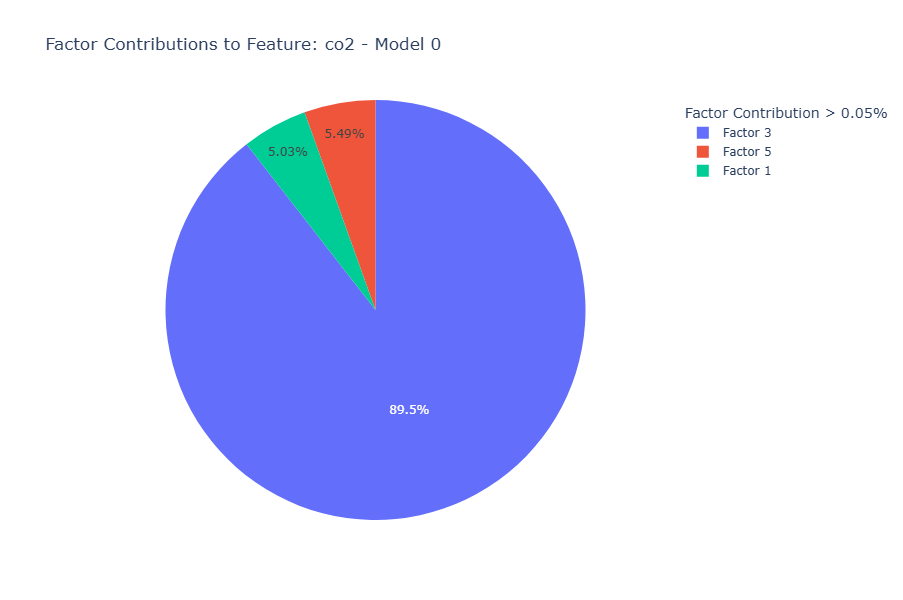

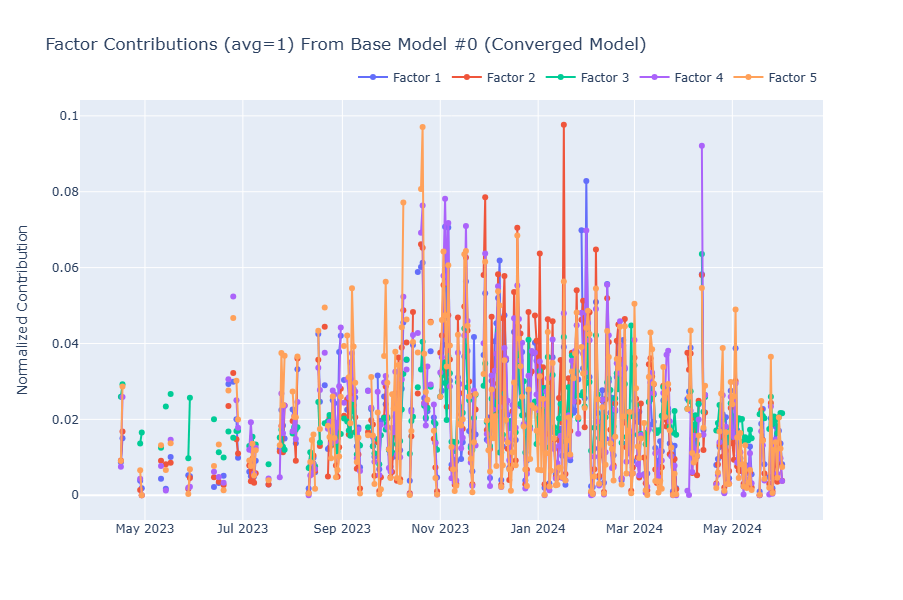

In [30]:
# Factor contribution pie chart shows the percentage of factor contributions for the specified feature, and the corresponding normalized contribution of each factor for that feature (bottom plot). Feature specified by index.
model_analysis.plot_factor_contributions(feature_idx=1)

In [1]:
# New Graphic: Factor Profile Composition Radar Graph
plt.rcParams["figure.figsize"] = (6, 4)
model_analysis.plot_factor_composition()

NameError: name 'plt' is not defined

C:\Users\jerry\AppData\Local\Programs\Python\Python310\lib\site-packages\esat\data\analysis.py:526: RuntimeWarning:

divide by zero encountered in divide

C:\Users\jerry\AppData\Local\Programs\Python\Python310\lib\site-packages\esat\data\analysis.py:526: RuntimeWarning:

invalid value encountered in divide



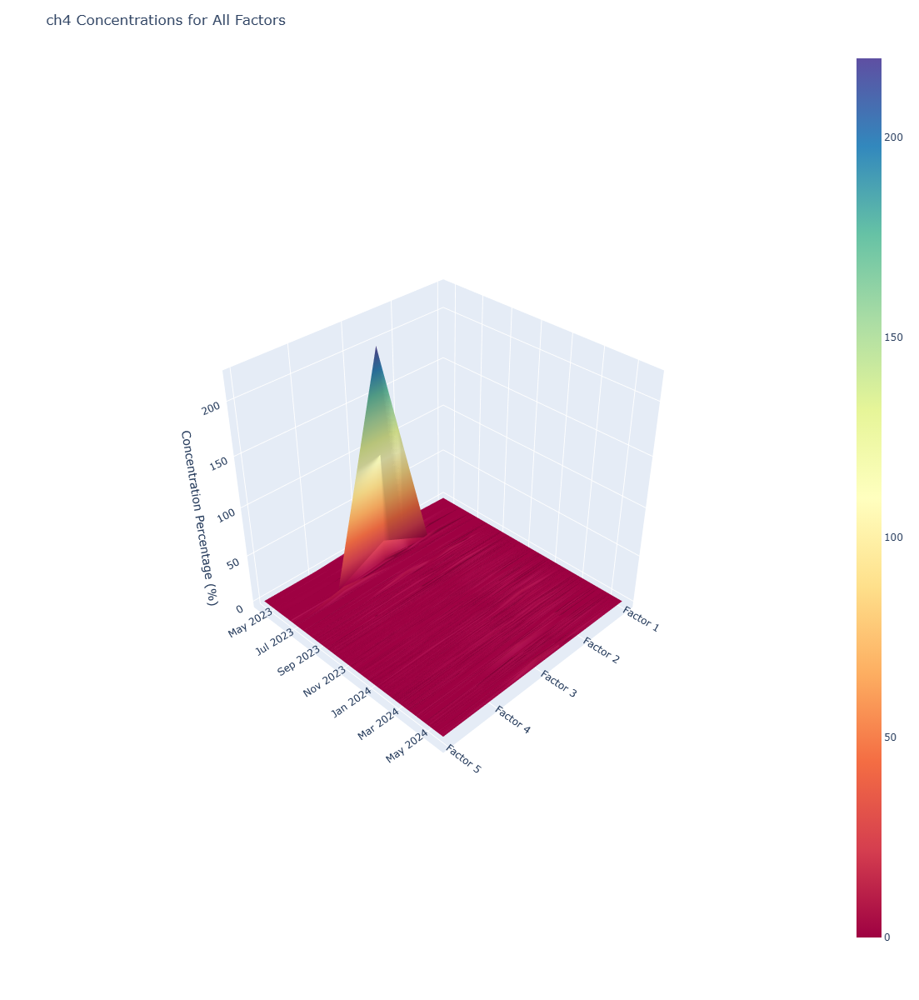

In [32]:
# New Graphic: Factor Contribution Surface Plot
factor_idx = None
feature_idx = 1
model_analysis.plot_factor_surface(factor_idx=factor_idx, feature_idx=feature_idx, percentage=True)